# Ефаринов Павел Андреевич ЛР1

### Установка зависимостей

In [ ]:
# Установка необходимых библиотек
!pip install gymnasium[accept-rom-license]
!pip install swig # требуется для сборки box2d
!pip install gymnasium[box2d]
!pip install stable-baselines3
!pip install PyVirtualDisplay
!sudo apt-get install xvfb

In [ ]:
# Импорт необходимых пакетов
import gymnasium as gym
from stable_baselines3 import DQN

### Выбор среды

[Lunar lander](https://gymnasium.farama.org/environments/box2d/lunar_lander/)

#### Создание среды

##### Action space

0. Ничего не делать
1. Поворот по часовой
2. Запуск основного двигателя
3. Поворот против часовой

##### Observation space

8-ми мерный вектор

Координаты X и Y, линейные скорости по осям, угол, угловая скорость, касается ли каждая из опор земли.

##### Параметры

* Continuous - при True action_space будет Box
* Gravity - Сила притяжения
* Enable wind - наличие ветра (выключен, для упрощения обучения)
* Turbulance power - Случайные изменения угла



In [ ]:
# Создание среды CartPole
env = gym.make("LunarLander-v2",
    continuous = False,
    gravity = -10.0,
    enable_wind = False,
    turbulence_power = 1.5,)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
# Инициализация модели DQN
model = DQN("MlpPolicy", env, verbose=1)

Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.


#### Обучение модели
Увеличен `timestamp` для успешного обучения. Для усорения используется GPU

In [ ]:
# Обучение модели
timestamp=500000
model.learn(total_timesteps=timestamp, log_interval=100)
model.save("Asteroids-v5")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


----------------------------------
| rollout/            |          |
|    ep_len_mean      | 94.4     |
|    ep_rew_mean      | -189     |
|    exploration_rate | 0.821    |
| time/               |          |
|    episodes         | 100      |
|    fps              | 6079     |
|    time_elapsed     | 1        |
|    total_timesteps  | 9439     |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 94.8     |
|    ep_rew_mean      | -190     |
|    exploration_rate | 0.641    |
| time/               |          |
|    episodes         | 200      |
|    fps              | 5159     |
|    time_elapsed     | 3        |
|    total_timesteps  | 18920    |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 89.5     |
|    ep_rew_mean      | -172     |
|    exploration_rate | 0.47     |
| time/               |          |
|    episodes       

#### Тестирование модели

1000


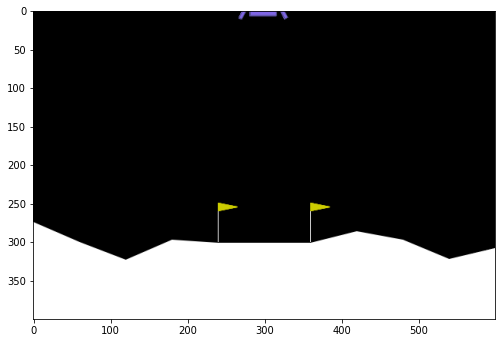

In [ ]:
from IPython import display
from pyvirtualdisplay import Display
import matplotlib.pyplot as plt
from matplotlib import animation


d = Display()
d.start()

env = gym.make('LunarLander-v2', render_mode="rgb_array")

obs, info = env.reset()

img = []
for _ in range(1000):
    action, _states = model.predict(obs, deterministic=True)
    obs, reward, terminated, truncated, info = env.step(action)

    display.clear_output(wait=True)
    img.append(env.render())
    # if d:
        # env.reset()

dpi = 72
interval = 50 # ms

plt.figure(figsize=(img[0].shape[1]/dpi,img[0].shape[0]/dpi),dpi=dpi)
patch = plt.imshow(img[0])
plt.axis=('off')
animate = lambda i: patch.set_data(img[i])
ani = animation.FuncAnimation(plt.gcf(),animate,frames=len(img),interval=interval)
display.display(display.HTML(ani.to_jshtml()))

#### Закрытие среды после тестирования

In [ ]:
# Закрытие среды после тестирования
env.close()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
